In [1]:
# Discover and load Planck PNG tiles as grayscale arrays for downstream analysis.
import os
import numpy as np
from PIL import Image
import matplotlib.lines as mlines 

# Locate Planck-branded PNG tiles within ./data for reproducible loading
data_folder_path = './data'
planck_image_data = [] # Holds {'filename': ..., 'path': ..., 'gsfield': ...}

print(f"Searching for PNG files starting with 'Planck' in: {data_folder_path}")

# Walk through the data folder and its subfolders
for root, dirs, files in os.walk(data_folder_path):
    for file in files:
        # Keep case-insensitive Planck-prefixed PNGs so alternate products are ignored
        if file.lower().startswith('planck') and file.lower().endswith('.png'):
            file_path = os.path.join(root, file)
            try:
                # Load the image via Pillow to preserve headers
                img = Image.open(file_path)
                
                # Convert to grayscale ('L' mode) to focus on temperature intensity
                # Enforcing a single channel keeps arrays lightweight and consistent
                img_gray = img.convert('L')
                
                # Turn the PIL image into a NumPy array for scientific tooling
                gsfield = np.array(img_gray)
                
                # Cache metadata and pixel data for later steps
                planck_image_data.append({
                    'filename': file,
                    'path': file_path,
                    'gsfield': gsfield
                })
                print(f"Successfully processed '{file}'. Matrix 'gsfield' shape: {gsfield.shape}")
                
            except Exception as e:
                print(f"Error processing file {file_path}: {e}")

# Loading summary
if not planck_image_data:
    print("No PNG files starting with 'Planck' found in the specified directory and its subdirectories.")
else:
    print(f"\nProcessed {len(planck_image_data)} image(s).")

Searching for PNG files starting with 'Planck' in: ./data
Successfully processed 'Planck_CMB_2.png'. Matrix 'gsfield' shape: (1550, 1932)

Processed 1 image(s).


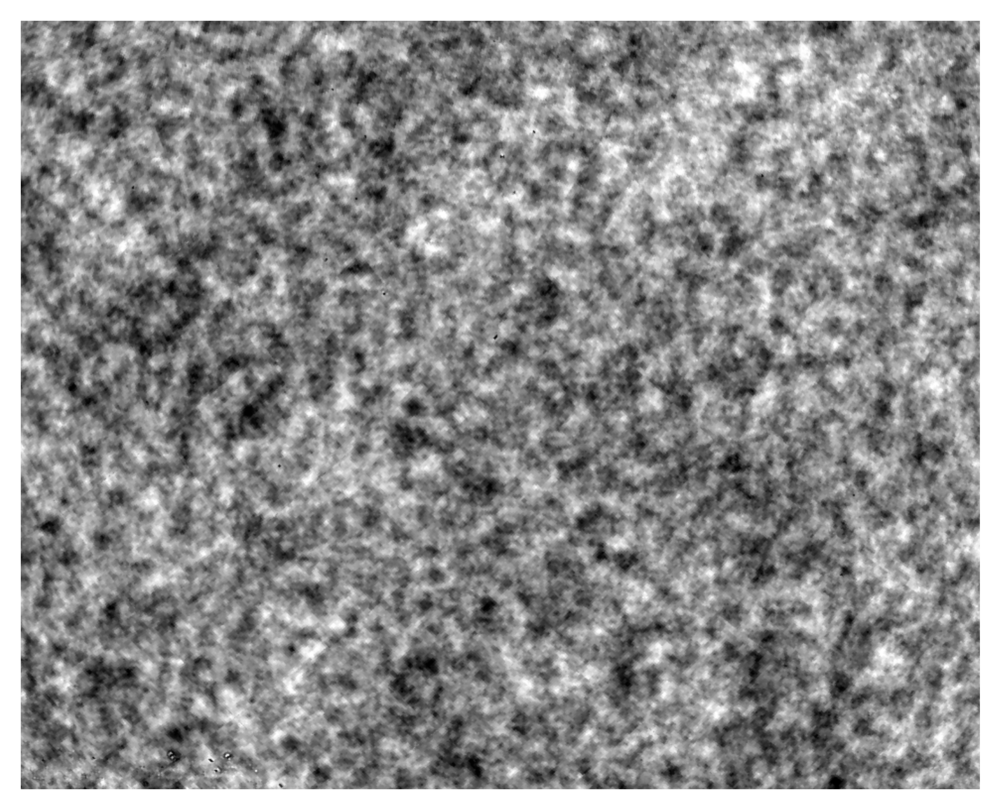

In [2]:
# Display each imported Planck map to sanity-check contrast and framing.
import matplotlib.pyplot as plt
import numpy as np # Ensure numpy is imported if not already in this cell
dpi = 300

if not planck_image_data:
    print("No image data to display. Please run the first cell to load images.")
else:
    num_images = len(planck_image_data)
    # Choose a subplot grid that keeps the gallery approximately square
    # This keeps figure whitespace balanced regardless of image count
    cols = int(np.ceil(np.sqrt(num_images)))
    rows = int(np.ceil(num_images / cols))
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 4), dpi=dpi) # Adjust figsize as needed
    
    # Normalise axis handling when only a single subplot is needed
    if num_images == 1:
        axes = [axes]
    else:
        axes = axes.flatten() # Flatten axes to simplify iteration
    
    for i, image_info in enumerate(planck_image_data):
        ax = axes[i]
        try:
            ax.imshow(image_info['gsfield'], cmap='gray')
            #ax.set_title('COM_CMB_IQU-commander_2048_R3.00_full', fontsize=8)
            ax.axis('off') # Hide axes ticks and labels
        except Exception as e:
            print(f"Error displaying image {image_info['filename']}: {e}")
            ax.set_title(f"Error: {image_info['filename']}", fontsize=8, color='red')
            ax.axis('off')
            
    # Hide any unused subplots
    for j in range(num_images, len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()

Plotting level 0 contours for 1 image(s)...


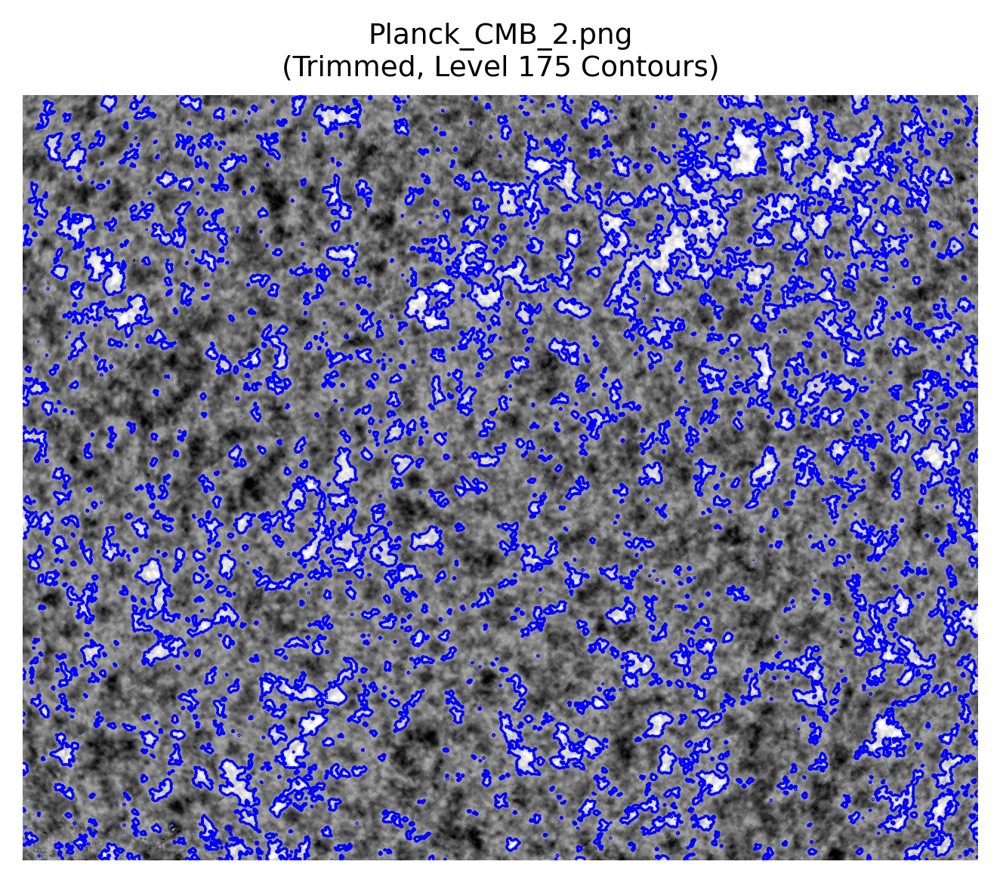


Variable 'contour0_all_lines_all_images' has been populated with contour data for 1 image(s).


In [3]:
# Trim noisy borders and extract level-set contours from every map.
contour0_all_lines_all_images = [] # Collect contour metadata per image for diagnostics
threshold_level = 175 # Default contour level (raise/lower to inspect other intensities)

if not planck_image_data:
    print("No image data to process for contours. Please run the first cell to load images.")
else:
    num_images = len(planck_image_data)
    cols = int(np.ceil(np.sqrt(num_images)))
    rows = int(np.ceil(num_images / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 4), dpi=dpi) # Adjusted figsize for better contour visibility

    if num_images == 1:
        # Ensure axes is always iterable, even for a single subplot
        if rows == 1 and cols == 1:
             axes = np.array([axes]) # Wrap single Axes object in a NumPy array
        else:
            # This case should ideally not happen if num_images is 1 and layout is 1x1
            # but as a fallback, flatten if it's already an array (e.g. from a 1xN or Nx1 layout)
            axes = np.array(axes).flatten()
    else:
        axes = axes.flatten()
        
    print(f"Plotting level 0 contours for {num_images} image(s)...")

    for i, image_info in enumerate(planck_image_data):
        ax = axes[i]
        gsfield_original = image_info['gsfield']
        filename = image_info['filename']
        
        try:
            # Remove the outermost rows/cols to reduce border noise before contouring
            if gsfield_original.shape[0] > 2: # Ensure there are more than 2 rows to remove from
                gsfield_trimmed = gsfield_original[1:-2, 1:-2] # Remove first and last rows and columns
            else:
                gsfield_trimmed = gsfield_original # Not enough rows to trim, use as is
                print(f"Image {filename} has too few rows ({gsfield_original.shape[0]}) to remove the first and last lines. Using original.")

            # Display the trimmed image for context
            ax.imshow(gsfield_trimmed, cmap='gray')
            
            # Overlay the requested contour level on the trimmed image
            contour_set = ax.contour(gsfield_trimmed, levels=[threshold_level], colors='blue', linewidths=0.8)
            # contour_all_set = ax.contourf(gsfield_trimmed, cmap='coolwarm', algorithm='threaded') # This was for filled contours, not requested for this step

            # Persist raw contour segments for later processing
            if contour_set.allsegs and len(contour_set.allsegs) > 0:
                level0_segments = contour_set.allsegs[0]
            else:
                level0_segments = [] # No contours found for this level
                
            contour0_all_lines_all_images.append({
                'filename': filename,
                'gsfield_shape_original': gsfield_original.shape,
                'gsfield_shape_trimmed': gsfield_trimmed.shape,
                'level0_segments': level0_segments
            })
            # contour0_all_lines = contour_set # This variable was causing confusion, using the list of dicts
            ax.set_title(f"{filename}\n(Trimmed, Level {threshold_level} Contours)", fontsize=9)
            ax.axis('off')
                     
        except Exception as e:
            print(f"Error processing or plotting contours for image {filename}: {e}")
            ax.set_title(f"Error: {filename}", fontsize=9, color='red')
            ax.axis('off')
            contour0_all_lines_all_images.append({
                'filename': filename,
                'gsfield_shape_original': gsfield_original.shape if 'gsfield_original' in locals() else None,
                'gsfield_shape_trimmed': None,
                'level0_segments': [],
                'error': str(e)
            })

    # Hide any unused subplots
    for j in range(num_images, len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()

    if contour0_all_lines_all_images:
        print(f"\nVariable 'contour0_all_lines_all_images' has been populated with contour data for {len(contour0_all_lines_all_images)} image(s).")
        # Example of how to inspect:
        # if contour0_all_lines_all_images:
        #     first_image_contours = contour0_all_lines_all_images[0]
        #     print(f"Contours for the first image ('{first_image_contours['filename']}'): {len(first_image_contours['level0_segments'])} lines found.")
        #     print(f"Original shape: {first_image_contours['gsfield_shape_original']}, Trimmed shape: {first_image_contours['gsfield_shape_trimmed']}")

if not planck_image_data: 
    pass 
elif not contour0_all_lines_all_images and planck_image_data: 
    print("\n'contour0_all_lines_all_images' is empty, though images were available. Check for errors during contour processing.")


Plotting level 0 contours for 1 image(s)...


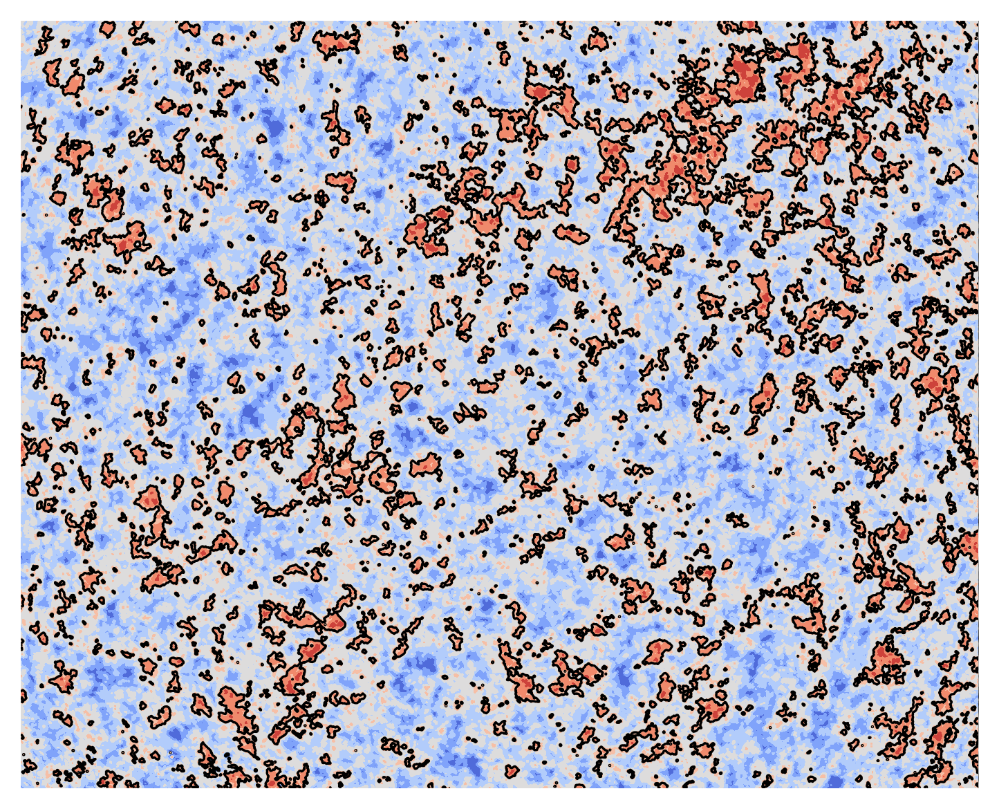

In [4]:
# Alternate contour pass that keeps columns intact and adds a filled overlay.
contour0_all_lines_all_images = [] # Collect contour metadata per image for diagnostics
# threshold_level = 100 # Example override if a different contour level is required

if not planck_image_data:
    print("No image data to process for contours. Please run the first cell to load images.")
else:
    num_images = len(planck_image_data)
    cols = int(np.ceil(np.sqrt(num_images)))
    rows = int(np.ceil(num_images / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 4), dpi=dpi) # Adjusted figsize for better contour visibility

    if num_images == 1:
        # Ensure axes is always iterable, even for a single subplot
        if rows == 1 and cols == 1:
             axes = np.array([axes]) # Wrap single Axes object in a NumPy array
        else:
            # This case should ideally not happen if num_images is 1 and layout is 1x1
            # but as a fallback, flatten if it's already an array (e.g. from a 1xN or Nx1 layout)
            axes = np.array(axes).flatten()
    else:
        axes = axes.flatten()
        
    print(f"Plotting level 0 contours for {num_images} image(s)...")

    for i, image_info in enumerate(planck_image_data):
        ax = axes[i]
        gsfield_original = image_info['gsfield']
        filename = image_info['filename']
        
        try:
            # Remove the outermost rows/cols to reduce border noise before contouring
            if gsfield_original.shape[0] > 2: # Ensure there are enough rows to remove
                gsfield = gsfield_original[1:-1, :]
            else:
                gsfield = gsfield_original # Not enough rows to remove, use as is
            
            # Display the modified image
            ax.imshow(gsfield, cmap='gray')
            
            # Calculate and plot contours for level 0 on the modified gsfield
            # Note: For plt.contour, X and Y are optional. If not given, they are assumed to be pixel indices.
            contour_set = ax.contour(gsfield, levels=[threshold_level], colors='k', linewidths=0.8)
            contour_all_set = ax.contourf(gsfield, cmap='coolwarm', algorithm='threaded')

            # Persist raw contour segments for later processing
            # contour_set.allsegs is a list of lists of arrays.
            # For a single level (levels=[0]), allsegs[0] contains all contour lines for that level.
            if contour_set.allsegs and len(contour_set.allsegs) > 0:
                level0_segments = contour_set.allsegs[0]
            else:
                level0_segments = [] # No contours found for this level
                
            contour0_all_lines_all_images.append({
                'filename': filename,
                'gsfield_shape': gsfield.shape, # Store shape of the modified gsfield
                'level0_segments': level0_segments
            })
            contour0_all_lines = contour_set # This variable seems to be overwritten in each loop, consider its usage.
                                         # If it's meant to collect all contours, it should be appended to or handled differently.
            #ax.set_title(f"{filename}\\n(Level 0 Contours, trimmed)", fontsize=9)
            ax.axis('off')
                     
        except Exception as e:
            print(f"Error processing or plotting contours for image {filename}: {e}")
            ax.set_title(f"Error: {filename}", fontsize=9, color='red')
            ax.axis('off')
            # Add an empty entry or specific error info to contour0_all_lines for this file
            contour0_all_lines_all_images.append({
                'filename': filename,
                'gsfield_shape': gsfield.shape if 'gsfield' in locals() else gsfield_original.shape, # Shape of gsfield if modified, else original
                'level0_segments': [],
                'error': str(e)
            })

    # Hide any unused subplots
    for j in range(num_images, len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()
    # imported_images = contour0_all_lines.copy()  # Copy the contour data for further use if needed
    # print(f"\nVariable 'contour0_all_lines' has been populated with contour data for {len(contour0_all_lines)} image(s).")
    # You can inspect contour0_all_lines. For example:
    # if contour0_all_lines:
    # print(f"Contours for the first image ('{contour0_all_lines[0]['filename']}'): {len(contour0_all_lines[0]['level0_segments'])} lines found.")

if not planck_image_data: # To handle the case where the first cell wasn't run or found no images
    pass # Message already printed at the beginning of the cell
elif not contour0_all_lines_all_images and planck_image_data: # Corrected variable name here
    print("\n'contour0_all_lines_all_images' is empty, though images were available. Check for errors during contour processing.")

Plotting only level 0 contours for 1 image(s) using plt.contour...


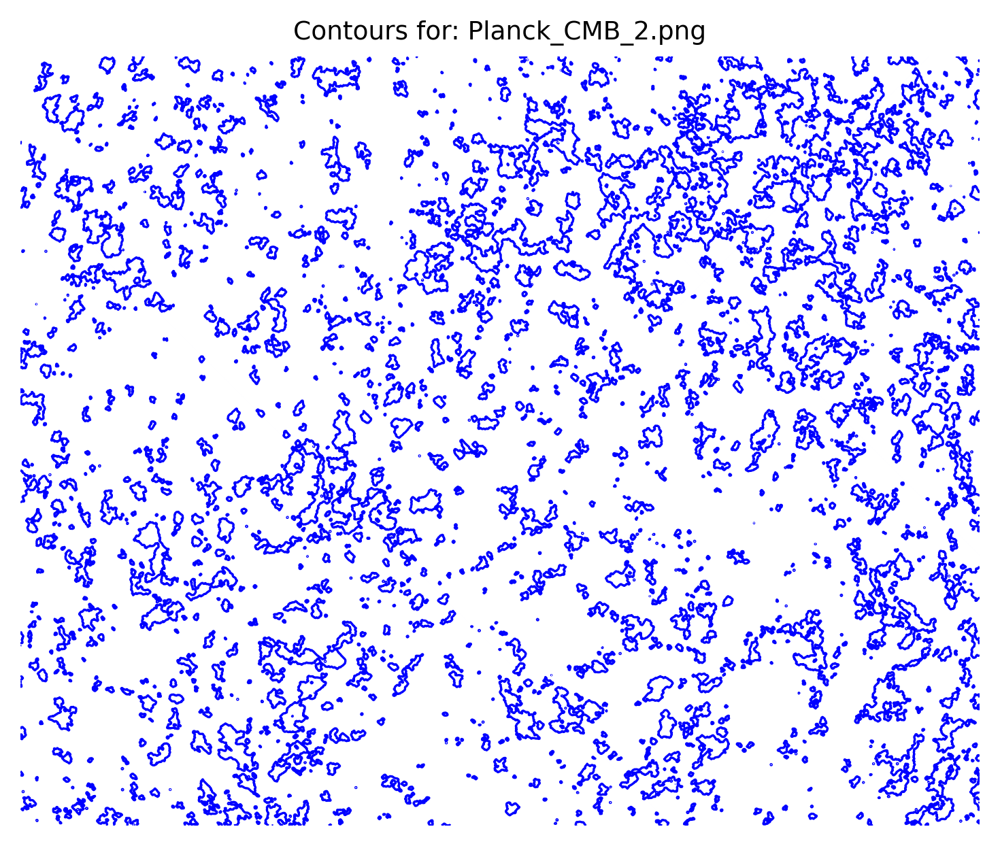

In [5]:
# Plot contour lines alone to emphasize level-set geometry without the raster.
if not planck_image_data:
    print("No image data to plot contours from. Please run the first cell to load images.")
else:
    num_images = len(planck_image_data)
    cols = int(np.ceil(np.sqrt(num_images)))
    rows = int(np.ceil(num_images / cols))
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5), dpi=dpi) # Adjust figsize as needed
    
    if num_images == 1:
        # Ensure axes is always iterable, even for a single subplot
        if rows == 1 and cols == 1:
             axes = np.array([axes]) 
        else:
            axes = np.array(axes).flatten()
    else:
        axes = axes.flatten()
        
    print(f"Plotting only level 0 contours for {num_images} image(s) using plt.contour...")

    for i, image_info in enumerate(planck_image_data):
        ax = axes[i]
        gsfield = image_info['gsfield']
        filename = image_info['filename']
        
        try:
            # Plot contours for level 0 directly using plt.contour
            # No background image (imshow) in this cell
            ax.contour(gsfield, levels=[threshold_level], colors='blue', linewidths=0.8) # Using blue for distinction
            
            ax.set_title(f"Contours for: {filename}", fontsize=9)
            # Invert y-axis to match image coordinate system (origin top-left)
            ax.invert_yaxis() 
            # Set aspect ratio to equal to avoid distortion of shapes
            ax.set_aspect('equal', adjustable='box') 
            ax.axis('off') # Optionally keep axis for coordinate reference, or turn off
            
        except Exception as e:
            print(f"Error plotting contours for image {filename}: {e}")
            ax.set_title(f"Error: {filename}", fontsize=9, color='red')
            ax.axis('off')

    # Hide any unused subplots
    for j in range(num_images, len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()

if not planck_image_data:
    pass # Message already printed

Processing all contours at level 175 to distribute a total of 10000000 equispaced points proportionally to contour lengths.
Total equispaced points calculated on level 175: 10000000 (target: 10000000)
Total normals calculated on level 175: 10000000


/Users/yohann/Library/Python/3.13/lib/python/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


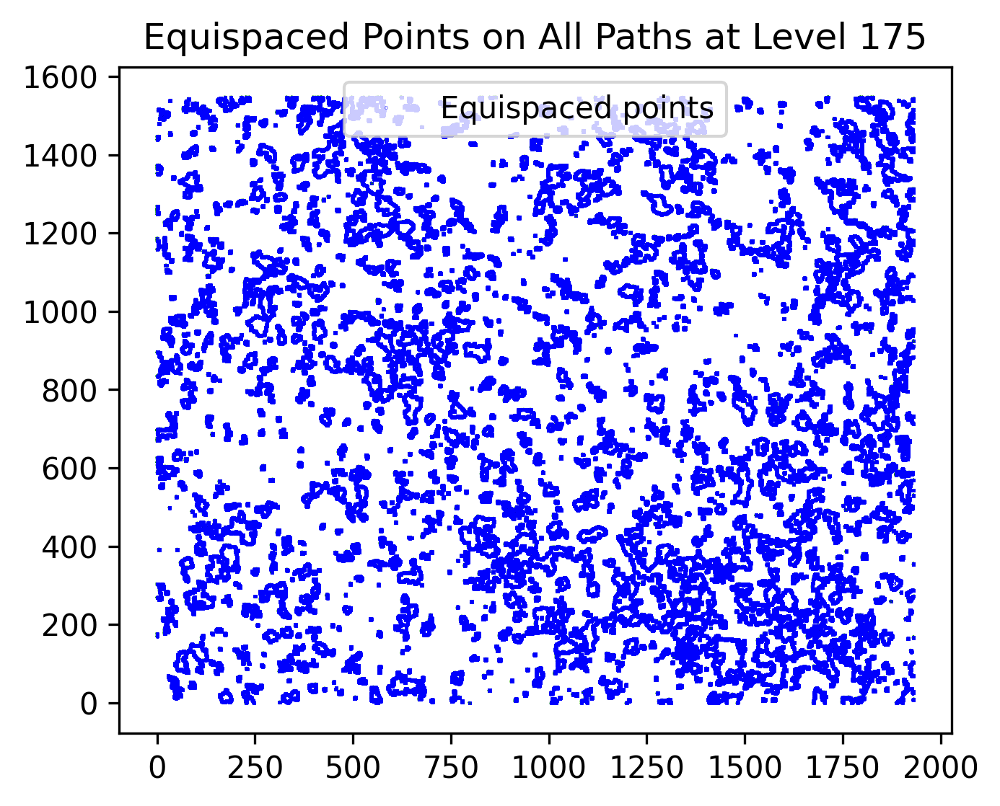

In [6]:
# Sample equispaced points and normals along every contour for later statistics.
# Allocate equispaced samples and normals across every level-set segment 
# for ALL contours at level 0 (derived from contour0_all_lines).
# This version both computes and visualises the samples.

# Ensure contour0_all_lines, nb_points_level_set, levels, figsize, dpi are defined from previous cells.
all_equispaced_points_level0 = []
all_normals_level0 = []
nb_points_level_set = int(1e7) # Set the number of equispaced points to distribute across all contours
figure_display = True # Set to True to display the figure with equispaced points and normals
levels = [threshold_level] # Assuming we are working with level 0 contours
display_figure = True # Set to True to display the figure with equispaced points and normals
calculation_done = False
dpi = 300
figsize = (6, 4) # Size of the figure for displaying equispaced points and normals

if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
   hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
   contour0_all_lines.allsegs[0] is not None and 'levels' in locals() and \
   'nb_points_level_set' in locals() and nb_points_level_set > 0:

    print(f"Processing all contours at level {levels[0]} to distribute a total of {nb_points_level_set} equispaced points proportionally to contour lengths.")

    valid_contour_paths_data = []
    total_length_all_valid_paths = 0.0

    # First pass: Calculate lengths and collect valid paths
    for contour_path_coords in contour0_all_lines.allsegs[0]:
        if len(contour_path_coords) < 2: # Need at least 2 points for a path
            continue

        path_segment_lengths_list = [np.sqrt((contour_path_coords[k][0] - contour_path_coords[k-1][0])**2 + \
                                        (contour_path_coords[k][1] - contour_path_coords[k-1][1])**2)
                                for k in range(1, len(contour_path_coords))]
        current_path_total_length = np.sum(path_segment_lengths_list)

        if current_path_total_length < 1e-9: # Skip very short or zero-length paths
            continue
        
        valid_contour_paths_data.append({
            "coords": contour_path_coords,
            "segment_lengths": path_segment_lengths_list, # Store the list of segment lengths
            "total_length": current_path_total_length
        })
        total_length_all_valid_paths += current_path_total_length

    if not valid_contour_paths_data or total_length_all_valid_paths < 1e-9:
        print(f"No valid contour paths found or total length is negligible at level {levels[0]}. Cannot distribute points.")
    else:
        # Distribute nb_points_level_set proportionally using Largest Remainder Method
        num_points_for_each_path_final = np.zeros(len(valid_contour_paths_data), dtype=int)
        
        path_lengths_array = np.array([path_data["total_length"] for path_data in valid_contour_paths_data])
        exact_allocations = (path_lengths_array / total_length_all_valid_paths) * nb_points_level_set
        
        num_points_for_each_path_final = np.floor(exact_allocations).astype(int)
        remainders = exact_allocations - num_points_for_each_path_final
        
        num_remaining_points_to_distribute = nb_points_level_set - np.sum(num_points_for_each_path_final)
        
        if num_remaining_points_to_distribute > 0:
            indices_sorted_by_remainder = np.argsort(remainders)[::-1] # Sort descending
            for k_rem in range(num_remaining_points_to_distribute):
                # Distribute remaining points to paths with largest remainders
                # Cycle through indices if num_remaining_points_to_distribute > len(paths)
                num_points_for_each_path_final[indices_sorted_by_remainder[k_rem % len(indices_sorted_by_remainder)]] += 1

        # Second pass: Generate points and normals for each path based on allocated points
        for i, path_data in enumerate(valid_contour_paths_data):
            num_points_this_path = num_points_for_each_path_final[i]

            if num_points_this_path <= 0: # If a path gets 0 points, skip it
                continue

            contour_path_coords_current = path_data["coords"]
            path_segment_lengths_current = path_data["segment_lengths"] # Use the stored list
            current_path_total_length_val = path_data["total_length"]
            
            equispaced_distances = np.linspace(0, current_path_total_length_val, num_points_this_path, endpoint=False)
            
            cumulative_lengths = np.cumsum(path_segment_lengths_current)
            segment_start_lengths = np.concatenate(([0.0], cumulative_lengths[:-1]))

            for dist in equispaced_distances:
                segment_idx = np.searchsorted(cumulative_lengths, dist, side='right')
                if segment_idx >= len(path_segment_lengths_current): # path_segment_lengths_current is a list
                    segment_idx = len(path_segment_lengths_current) - 1
                
                pt_A = contour_path_coords_current[segment_idx]
                pt_B = contour_path_coords_current[segment_idx + 1]

                dist_into_segment = dist - segment_start_lengths[segment_idx]
                segment_len = path_segment_lengths_current[segment_idx]
                ratio = 0.0 if segment_len < 1e-9 else dist_into_segment / segment_len
                ratio = np.clip(ratio, 0.0, 1.0)

                x_p = pt_A[0] + ratio * (pt_B[0] - pt_A[0])
                y_p = pt_A[1] + ratio * (pt_B[1] - pt_A[1])
                all_equispaced_points_level0.append(np.array([x_p, y_p]))

                dx_tangent = pt_B[0] - pt_A[0]
                dy_tangent = pt_B[1] - pt_A[1]
                nx = -dy_tangent
                ny = dx_tangent
                norm_magnitude = np.sqrt(nx**2 + ny**2)
                if norm_magnitude > 1e-9:
                    nx /= norm_magnitude
                    ny /= norm_magnitude
                else:
                    nx, ny = 0.0, 0.0 
                all_normals_level0.append(np.array([nx, ny]))
        
        if all_equispaced_points_level0:
            print(f"Total equispaced points calculated on level {levels[0]}: {len(all_equispaced_points_level0)} (target: {nb_points_level_set})")
            print(f"Total normals calculated on level {levels[0]}: {len(all_normals_level0)}")
            calculation_done = True
        else:
            print(f"No equispaced points were calculated for level {levels[0]}. This might happen if all paths were allocated 0 points.")

else:
    print("Could not calculate equispaced points and normals for all level 0 contours. " +
          "Missing prerequisites or 'contour0_all_lines' is not structured as expected.")

# Plotting the equispaced points
if display_figure and calculation_done and all_equispaced_points_level0 and \
   'figsize' in locals() and 'dpi' in locals():
    
    fig_all_level_set_pts, ax_all_level_set_pts = plt.subplots(figsize=figsize, dpi=dpi)

    if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
       hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
       contour0_all_lines.allsegs[0] is not None:
        for contour_path_coords_plot in contour0_all_lines.allsegs[0]:
            if len(contour_path_coords_plot) > 1: # Need at least 2 points to plot a line
                xs_orig, ys_orig = zip(*contour_path_coords_plot)
                ax_all_level_set_pts.plot(xs_orig, ys_orig, color='green', linewidth=1)
    else:
        print("Original contours (contour0_all_lines) not available for plotting background.")

    points_array = np.array(all_equispaced_points_level0)
    if points_array.size > 0 and points_array.ndim == 2 and points_array.shape[1] == 2:
        ax_all_level_set_pts.plot(points_array[:, 0], points_array[:, 1], 'bo', markersize=0.1, label=f'Equispaced points')
        ax_all_level_set_pts.legend()
    else:
        print("'all_equispaced_points_level0' is empty or not in the correct format for plotting, even though calculation was marked done.")

    ax_all_level_set_pts.axis('scaled')
    title_level_str = str(levels[0]) if 'levels' in locals() and isinstance(levels, list) and len(levels) > 0 else "N/A"
    ax_all_level_set_pts.set_title(f'Equispaced Points on All Paths at Level {title_level_str}')
    plt.grid(False)
    plt.show()

elif calculation_done and not all_equispaced_points_level0:
    print("Calculation was marked as done, but 'all_equispaced_points_level0' is empty. Nothing to plot.")
else:
    missing_plot_vars = []
    if not calculation_done:
        missing_plot_vars.append("calculation was not successful")
    if 'figsize' not in locals():
        missing_plot_vars.append("'figsize'")
    if 'dpi' not in locals():
        missing_plot_vars.append("'dpi'")
    print(f"Skipping plotting of equispaced points for level 0. Reasons: {', '.join(missing_plot_vars)}, or 'display_figure' is False.")


In [7]:
# Convert accumulated contour lengths into perimeter estimates at the chosen level.
# Convert contour lengths into a perimeter estimate for level 0
# This cell assumes 'calculation_done' and 'total_length_all_valid_paths' (from cell 12) are available.
rescale_gs_tools = 1.0 # Rescale factor for physical units, adjust as needed

if 'calculation_done' in locals() and calculation_done and \
   'total_length_all_valid_paths' in locals():
    
    perimeter_level_set0 = total_length_all_valid_paths
    print(f"Perimeter of the level set {levels[0]}: {perimeter_level_set0:.2f}")
    
    # Displaying it as a variable named 'perimeter' as requested (though the variable is perimeter_level_set0)
    perimeter = perimeter_level_set0 * rescale_gs_tools # Rescale to physical units
    print(f"Variable 'perimeter' (representing perimeter of level set {levels[0]}): {perimeter:.2f}")

else:
    print("Skipping perimeter calculation for level set 0: Prerequisites not met.")
    print("Ensure cell 12 has run successfully and 'calculation_done' is True and 'total_length_all_valid_paths' is available.")
    perimeter_level_set0 = None # Define it as None if not calculated
    perimeter = None
    if 'calculation_done' not in locals() or not calculation_done:
        print("- 'calculation_done' is not True or not defined.")
    if 'total_length_all_valid_paths' not in locals():
        print("- 'total_length_all_valid_paths' is not defined.")

Perimeter of the level set 175: 113897.80
Variable 'perimeter' (representing perimeter of level set 175): 113897.80


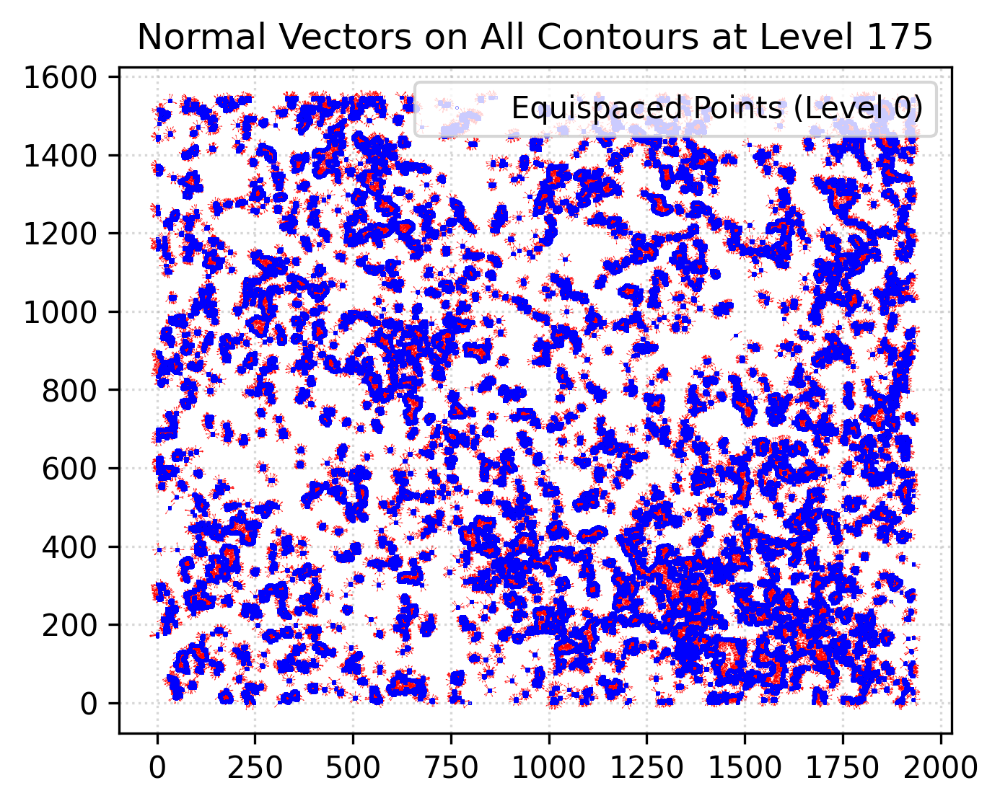

In [8]:
# Visualize contour normals to ensure the sampling covers every orientation.
# Visual inspection of normals attached to the equispaced contour samples
# This cell assumes 'calculation_done', 'all_equispaced_points_level0', 
# 'all_normals_level0', 'contour0_all_lines', 'figsize', 'dpi', 'levels' are available.
nb_points_display = int(1e5) # Number of points to display in the figure, adjust as needed

if display_figure and calculation_done and \
   'all_equispaced_points_level0' in locals() and len(all_equispaced_points_level0) > 0 and \
   'all_normals_level0' in locals() and len(all_normals_level0) == len(all_equispaced_points_level0):

    fig_all_normals, ax_all_normals = plt.subplots(figsize=figsize, dpi=dpi)

    # Plot original contours for context
    if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
       hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
       contour0_all_lines.allsegs[0] is not None:
        for contour_path_coords_plot in contour0_all_lines.allsegs[0]:
            if len(contour_path_coords_plot) > 1:
                xs_orig, ys_orig = zip(*contour_path_coords_plot)
                ax_all_normals.plot(xs_orig, ys_orig, color='gray', linewidth=0.5, alpha=0.7)
    
    points_array = np.array(all_equispaced_points_level0)
    normals_array = np.array(all_normals_level0)

    if points_array.ndim == 2 and points_array.shape[1] == 2 and \
       normals_array.ndim == 2 and normals_array.shape[1] == 2:
        
        # Plot the equispaced points
        ax_all_normals.plot(points_array[:, 0], points_array[:, 1], 'bo', markersize=0.1, label=f'Equispaced Points (Level 0)')
        
        # Plot the normal vectors
        # Subsample normals for clarity if there are too many
        subsample_rate = 1
        if len(points_array) > nb_points_display:
            subsample_rate = len(points_array) // nb_points_display # Aim for around nb_points_display arrows
            
        ax_all_normals.quiver(points_array[::subsample_rate, 0], points_array[::subsample_rate, 1], 
                                normals_array[::subsample_rate, 0], normals_array[::subsample_rate, 1], 
                                color='red', units='xy', scale_units='xy', scale=0.05, width=1, headwidth=3, headlength=4, pivot='tail')
        # Note: 'scale', 'width' might need adjustment depending on the density and scale of points.
        # Using 'units='xy', scale_units='xy'' makes the arrow scale with the data units.
        # A smaller 'scale' value makes arrows longer.

    ax_all_normals.axis('scaled')
    title_level_str = str(levels[0]) if 'levels' in locals() and isinstance(levels, list) and len(levels) > 0 else "N/A"
    ax_all_normals.set_title(f'Normal Vectors on All Contours at Level {title_level_str}')
    ax_all_normals.legend()
    plt.grid(True, linestyle=':', alpha=0.5)
    plt.show()
else:
    print("Skipping visualization of normal vectors for all level 0 contours: " +
          "Calculation was not done, or points/normals data is missing or mismatched, or 'display_figure' is False.")

In [9]:
# Compute Euler characteristic plus Contour integrals from the global normals.
# Calculate Euler Characteristic from normals on level 0 contours
# This cell assumes 'calculation_done', 'all_normals_level0',
# 'valid_contour_paths_data', 'num_points_for_each_path_final', and 'levels' (from cell 12 or earlier) are available.
from skimage.measure import euler_number

if 'calculation_done' in locals() and calculation_done and \
   'all_normals_level0' in locals() and len(all_normals_level0) > 0 and \
   'valid_contour_paths_data' in locals() and \
   'num_points_for_each_path_final' in locals() and \
   'levels' in locals():

    total_sum_of_angle_changes = 0.0
    current_offset = 0
    total_sum_cos_cabana = 0.0
    total_sum_sin_cabana = 0.0
    total_perimeter_cabana = 0.0

    print(f"Calculating statistics for level set {levels[0]}...")

    for i_path in range(len(valid_contour_paths_data)):
        num_normals_on_this_path = num_points_for_each_path_final[i_path]

        if num_normals_on_this_path < 2: # Need at least 2 normals to calculate angle change along a path segment
            current_offset += num_normals_on_this_path
            continue

        path_normals = all_normals_level0[current_offset : current_offset + num_normals_on_this_path]
        path_points = all_equispaced_points_level0[current_offset : current_offset + num_normals_on_this_path]
        
        
        # Calculate angles for each normal vector on this path
        # Angles are in radians, from -pi to pi, using arctan2(ny, nx)
        angles_on_path = [np.arctan2(normal[1], normal[0]) for normal in path_normals]
        distances_on_path = np.sqrt(np.sum(np.diff(path_points, axis=0)**2, axis=1))

        path_angle_change_sum_for_this_contour = 0.0
        path_distance_change_sum_for_this_contour = 0.0
        # Iterate through normals to sum angle differences
        # including the change from the last normal back to the first to close the loop
        for j in range(num_normals_on_this_path):
            angle1 = angles_on_path[j-1] # For j=0, this is angles_on_path[-1] (last normal's angle)
            angle2 = angles_on_path[j]

            distance = distances_on_path[j] if j < num_normals_on_this_path - 1 else 0 
            # Avoid last point distance by setting it to 0
            # Calculate the cosine and sine of the angle for Contour's formula
            cos_cabana = np.cos(2*angle2)
            sin_cabana = np.sin(2*angle2)
            total_sum_cos_cabana += distance * cos_cabana
            total_sum_sin_cabana += distance * sin_cabana
 
            delta_angle = angle2 - angle1
            if j==0:
                delta_angle = 0           
            # Correct delta_angle to be in (-pi, pi]
            # This ensures we take the shortest angle between the two vectors
            if delta_angle > np.pi:
                delta_angle -= 2 * np.pi
            elif delta_angle <= -np.pi: # Use <= to handle the case of exactly -pi vs +pi if it occurs
                delta_angle += 2 * np.pi
            # Accumulate the angle change and distance
            path_angle_change_sum_for_this_contour += delta_angle
            path_distance_change_sum_for_this_contour += distance
            
        total_sum_of_angle_changes += path_angle_change_sum_for_this_contour
        total_perimeter_cabana += path_distance_change_sum_for_this_contour
        current_offset += num_normals_on_this_path

    if current_offset != len(all_normals_level0):
        print(f"Warning: Mismatch in total normals processed ({current_offset}) and available normals ({len(all_normals_level0)}).")


    euler_characteristic = total_sum_of_angle_changes / (2 * np.pi)
    bool_image = (gsfield > levels[0])
    euler_characteristic_scikit = euler_number(bool_image, connectivity=1)
    euler_characteristic_scikit2 = euler_number(bool_image, connectivity=2)
    print(f"Euler Characteristic (manual calculation): {euler_characteristic:.4f}")
    print(f"Euler Characteristic (scikit-image): {euler_characteristic_scikit:.4f}")
    print(f"Euler Characteristic (scikit-image, connectivity=2): {euler_characteristic_scikit2:.4f}")
    cos_cabana_integral = total_sum_cos_cabana * rescale_gs_tools
    # Rescale to physical units
    sin_cabana_integral = total_sum_sin_cabana * rescale_gs_tools
    # Rescale to physical units
    total_perimeter_cabana *= rescale_gs_tools # Rescale to physical units
    
    print(f"Integral Cosine of Contour's formula: {cos_cabana_integral:.4f}")
    print(f"Integral Sine of Contour's formula: {sin_cabana_integral:.4f}")
    print(f"Total number of normals processed: {len(all_normals_level0)}")

    estimated_angle_cabana = -(1/2)*np.arctan(sin_cabana_integral/cos_cabana_integral)+np.pi/2
    # The angle is estimated from Contour's formula
    # This is a rough estimate of the average angle of normals
    # The formula is derived from the mean of the normals' angles
    print(f"Estimated angle from Contour's formula: {estimated_angle_cabana:.4f} radians")
    print(f'Contour length of level set {levels[0]}: {total_perimeter_cabana:.4f}')
    print(f"Variable 'perimeter' (representing perimeter of level set {levels[0]}): {perimeter:.2f}")

else:
    print("Skipping Euler Characteristic calculation: Prerequisites not met. ")
    print("Ensure cell 12 (the one calculating 'all_normals_level0', etc.) has run successfully, ")
    print("'calculation_done' is True, and all required variables are available in the global scope.")
    # Listing potentially missing variables for debugging:
    for var_name in ['calculation_done', 'all_normals_level0', 'valid_contour_paths_data', 'num_points_for_each_path_final', 'levels']:
        if var_name not in locals():
            print(f"Missing variable: {var_name}")

Calculating statistics for level set 175...
Euler Characteristic (manual calculation): 1591.0676
Euler Characteristic (scikit-image): 1921.0000
Euler Characteristic (scikit-image, connectivity=2): 1766.0000
Integral Cosine of Contour's formula: 4923.5883
Integral Sine of Contour's formula: -1738.8023
Total number of normals processed: 10000000
Estimated angle from Contour's formula: 1.7405 radians
Contour length of level set 175: 113841.7694
Variable 'perimeter' (representing perimeter of level set 175): 113897.80


In [10]:
# Measure the sublevel-set area corresponding to the current brightness threshold.
# Calculate the volume (area) of the sublevel set 0 and its proportion
# This cell assumes 'gsfield', 'levels', and 'field_size' are available from previous cells.

if 'gsfield' in locals() and 'levels' in locals() and len(levels) > 0 :
    target_level = levels[0]

    # Calculate the area of the sublevel set (pixels <= target_level)
    # In a 2D grid, the "volume" is the count of pixels satisfying the condition.
    sublevel_set_area = np.sum(gsfield <= target_level) * rescale_gs_tools**2 # Rescale to physical units
    
    # Calculate the total area of the field
    total_field_area = gsfield.shape[0] * gsfield.shape[1] * rescale_gs_tools**2 # Rescale to physical units

    # Calculate the proportion
    if total_field_area > 0:
        proportion_sublevel_set = sublevel_set_area / total_field_area
    else:
        proportion_sublevel_set = 0 # Avoid division by zero if field_size is 0
        
    print(f"Target level for sublevel set: {target_level}")
    print(f"Area (in physical units) of the sublevel set (Z <= {target_level}): {sublevel_set_area}")
    print(f"Total area of the field (in physical units): {total_field_area}")
    print(f"Proportion of the sublevel set area to total area: {proportion_sublevel_set:.4f}")

    # Assign to variables as requested (optional, but good for potential later use)
    volume_sublevel_set_0 = sublevel_set_area
    proportion_volume_sublevel_set_0 = proportion_sublevel_set

else:
    print("Skipping calculation of sublevel set volume and proportion: Prerequisites not met.")
    missing_vars = []
    if 'gsfield' not in locals():
        missing_vars.append("'gsfield'")
    if 'levels' not in locals() or not levels:
        missing_vars.append("'levels' (or it's empty)")
    if 'field_size' not in locals():
        missing_vars.append("'field_size'")
    if missing_vars:
        print(f"Missing variables: {', '.join(missing_vars)}")

Target level for sublevel set: 175
Area (in physical units) of the sublevel set (Z <= 175): 2582952.0
Total area of the field (in physical units): 2994600.0
Proportion of the sublevel set area to total area: 0.8625


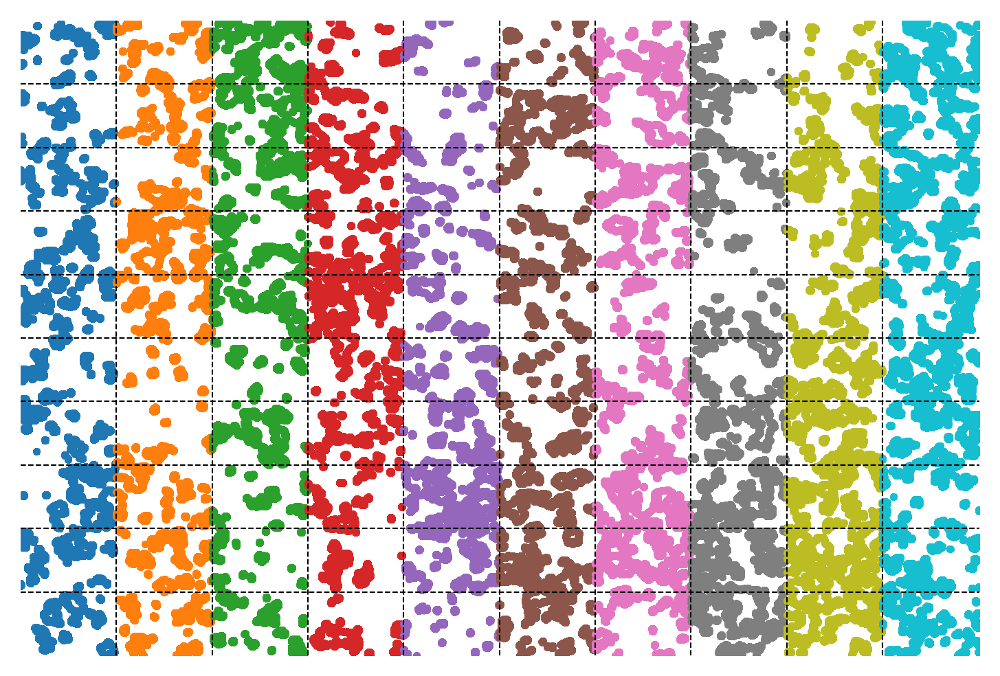

Cell (0, 0): 89382 points
Cell (0, 1): 97707 points
Cell (0, 2): 81312 points
Cell (0, 3): 69337 points
Cell (0, 4): 27564 points
Cell (0, 5): 108110 points
Cell (0, 6): 92287 points
Cell (0, 7): 174298 points
Cell (0, 8): 165181 points
Cell (0, 9): 135523 points
Cell (1, 0): 99726 points
Cell (1, 1): 103628 points
Cell (1, 2): 46628 points
Cell (1, 3): 58802 points
Cell (1, 4): 112622 points
Cell (1, 5): 135070 points
Cell (1, 6): 169858 points
Cell (1, 7): 174034 points
Cell (1, 8): 195954 points
Cell (1, 9): 122353 points
Cell (2, 0): 114847 points
Cell (2, 1): 91231 points
Cell (2, 2): 56529 points
Cell (2, 3): 69408 points
Cell (2, 4): 192495 points
Cell (2, 5): 123380 points
Cell (2, 6): 154004 points
Cell (2, 7): 156563 points
Cell (2, 8): 159143 points
Cell (2, 9): 83974 points
Cell (3, 0): 69979 points
Cell (3, 1): 42660 points
Cell (3, 2): 105871 points
Cell (3, 3): 92271 points
Cell (3, 4): 102675 points
Cell (3, 5): 80467 points
Cell (3, 6): 84252 points
Cell (3, 7): 128685

In [11]:
# Bin contour samples into a coarse grid to study spatial heterogeneity.
# Bucket each sampled point/normal into a coarse spatial grid
factor_divide = 10
cell_height = gsfield.shape[0] // factor_divide
cell_width = gsfield.shape[1] // factor_divide

# Create a nested list to store points for each cell
all_cells_equispaced_points = [[[] for _ in range(factor_divide)] for _ in range(factor_divide)]
all_cells_normals = [[[] for _ in range(factor_divide)] for _ in range(factor_divide)]

for point, normal in zip(all_equispaced_points_level0, all_normals_level0):
    col_idx = int(point[0] // cell_width)
    row_idx = int(point[1] // cell_height)
    
    # Clamp indices to be within the grid
    col_idx = min(col_idx, factor_divide - 1)
    row_idx = min(row_idx, factor_divide - 1)
    
    all_cells_equispaced_points[row_idx][col_idx].append(point)
    all_cells_normals[row_idx][col_idx].append(normal)

# Visual recap of the spatial distribution
fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
# ax.imshow(gsfield, cmap='gray', origin='lower')

# Draw grid lines
for i in range(1, factor_divide):
    ax.axhline(y=i * cell_height, color='black', linestyle='--', linewidth=0.5)
    ax.axvline(x=i * cell_width, color='black', linestyle='--', linewidth=0.5)

# Plot points cell by cell
for i in range(factor_divide):
    for j in range(factor_divide):
        if all_cells_equispaced_points[i][j]:
            points_in_cell = np.array(all_cells_equispaced_points[i][j])
            ax.scatter(points_in_cell[:, 0], points_in_cell[:, 1], s=2)

ax.axis([0, gsfield.shape[1], 0, gsfield.shape[0]])
#ax.set_title(f'Equispaced Points Distributed in a {factor_divide}x{factor_divide} Grid')
plt.axis('off')
plt.savefig("view_on_gf_cells.png", bbox_inches='tight')
plt.grid(False)
plt.show()

# Print summary
for i in range(factor_divide):
    for j in range(factor_divide):
        num_points = len(all_cells_equispaced_points[i][j])
        print(f"Cell ({i}, {j}): {num_points} points")

/Users/yohann/Library/Python/3.13/lib/python/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


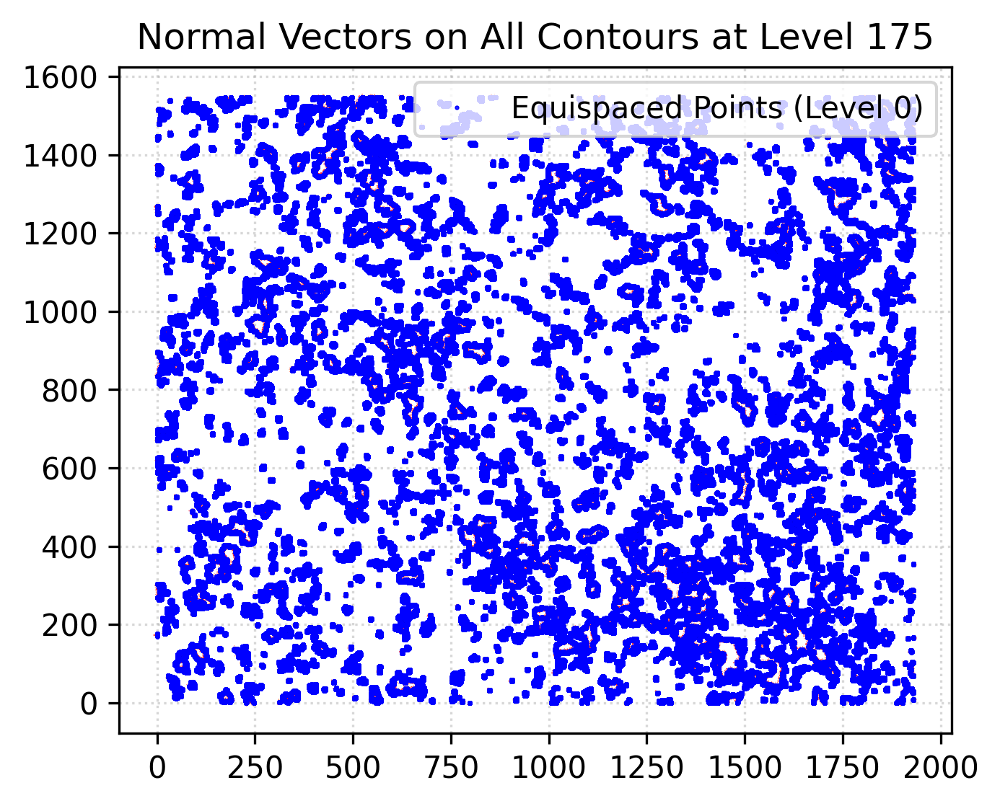

/var/folders/rx/zp2zlnw970z7wf587wzdc3rw0000gn/T/ipykernel_17436/1666916137.py:60: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('viridis', factor_divide*factor_divide)


In [12]:
# Render contour normals again, highlighting per-cell behavior with color coding.
# Visual inspection of normals attached to the equispaced contour samples
# This cell assumes 'calculation_done', 'all_equispaced_points_level0', 
# 'all_normals_level0', 'contour0_all_lines', 'figsize', 'dpi', 'levels' are available.

if display_figure and calculation_done and \
   'all_equispaced_points_level0' in locals() and len(all_equispaced_points_level0) > 0 and \
   'all_normals_level0' in locals() and len(all_normals_level0) == len(all_equispaced_points_level0):

    fig_all_normals, ax_all_normals = plt.subplots(figsize=figsize, dpi=dpi)

    # Plot original contours for context
    if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
       hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
       contour0_all_lines.allsegs[0] is not None:
        for contour_path_coords_plot in contour0_all_lines.allsegs[0]:
            if len(contour_path_coords_plot) > 1:
                xs_orig, ys_orig = zip(*contour_path_coords_plot)
                ax_all_normals.plot(xs_orig, ys_orig, color='gray', linewidth=0.5, alpha=0.7)
    
    points_array = np.array(all_equispaced_points_level0)
    normals_array = np.array(all_normals_level0)

    if points_array.ndim == 2 and points_array.shape[1] == 2 and \
       normals_array.ndim == 2 and normals_array.shape[1] == 2:
        
        # Plot the equispaced points
        ax_all_normals.plot(points_array[:, 0], points_array[:, 1], 'bo', markersize=0.5, label=f'Equispaced Points (Level 0)')
        
        # Plot the normal vectors
        # Subsample normals for clarity if there are too many
        subsample_rate = 1
        if len(points_array) > nb_points_display:
            subsample_rate = len(points_array) // nb_points_display # Aim for around nb_points_display arrows
            
        ax_all_normals.quiver(points_array[::subsample_rate, 0], points_array[::subsample_rate, 1], 
                                normals_array[::subsample_rate, 0], normals_array[::subsample_rate, 1], 
                                color='red', units='xy', scale_units='xy', scale=0.1, width=0.5, headwidth=3, headlength=4, pivot='tail')
        # Note: 'scale', 'width' might need adjustment depending on the density and scale of points.
        # Using 'units='xy', scale_units='xy'' makes the arrow scale with the data units.
        # A smaller 'scale' value makes arrows longer.

    ax_all_normals.axis('scaled')
    title_level_str = str(levels[0]) if 'levels' in locals() and isinstance(levels, list) and len(levels) > 0 else "N/A"
    ax_all_normals.set_title(f'Normal Vectors on All Contours at Level {title_level_str}')
    ax_all_normals.legend()
    plt.grid(True, linestyle=':', alpha=0.5)
    plt.show()
else:
    print("Skipping visualization of normal vectors for all level 0 contours: " +
          "Calculation was not done, or points/normals data is missing or mismatched, or 'display_figure' is False.")

# Visualization of normal vectors for each cell with a different color

if 'all_cells_equispaced_points' in locals() and 'all_cells_normals' in locals():
    fig, ax = plt.subplots(figsize=figsize, dpi=8*dpi)
    # ax.imshow(gsfield, cmap='gray', origin='lower', alpha=0.5)

    # Create a colormap
    colors = plt.cm.get_cmap('viridis', factor_divide*factor_divide)

    # Draw grid lines
    for i in range(1, factor_divide):
        ax.axhline(y=i * cell_height, color='black', linestyle='--', linewidth=0.5)
        ax.axvline(x=i * cell_width, color='black', linestyle='--', linewidth=0.5)

    # Plot normals for each cell
    cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    size_cycle = len(cycle)
    for i in range(factor_divide):
        for j in range(factor_divide):
            if all_cells_equispaced_points[i][j]:
                points_in_cell = np.array(all_cells_equispaced_points[i][j])
                normals_in_cell = np.array(all_cells_normals[i][j])
                #color = colors(plt.rcParams['axes.prop_cycle'][i * factor_divide + j]) # Use a distinct color for each cell

                # Subsample for clarity
                subsample_rate = 1
                if len(points_in_cell) > (nb_points_display / (factor_divide**2)):
                    subsample_rate = int(len(points_in_cell) // (nb_points_display / (factor_divide**2)))
                
                ax.quiver(points_in_cell[::subsample_rate, 0], points_in_cell[::subsample_rate, 1], 
                          normals_in_cell[::subsample_rate, 0], normals_in_cell[::subsample_rate, 1], 
                          color=cycle[(i * factor_divide + j) % size_cycle], units='xy', scale_units='xy', scale=0.1, width=0.5, 
                          headwidth=3, headlength=4, pivot='tail')

    #ax.axis([0, gsfield.shape[1], 0, gsfield.shape[0]])
    #ax.set_title(f'Normal Vectors by Cell')
    #plt.tight_layout()
    plt.axis('off')
    plt.savefig("view_on_gf_cell_normals.png", bbox_inches='tight')
    plt.grid(False)
    plt.show()
else:
    print("Data for cells not available. Please run cell 6 first.")

In [13]:
# Recompute Euler/Contour summaries per grid cell and assemble a table of results.
# Calculate Euler Characteristic from normals on level 0 contours
# This cell assumes 'calculation_done', 'all_normals_level0',
# 'valid_contour_paths_data', 'num_points_for_each_path_final', and 'levels' (from cell 12 or earlier) are available.

if 'calculation_done' in locals() and calculation_done and \
   'all_normals_level0' in locals() and len(all_normals_level0) > 0 and \
   'valid_contour_paths_data' in locals() and \
   'num_points_for_each_path_final' in locals() and \
   'levels' in locals():

    total_sum_of_angle_changes = 0.0
    current_offset = 0
    total_sum_cos_cabana = 0.0
    total_sum_sin_cabana = 0.0
    total_perimeter_cabana = 0.0

    print(f"Calculating statistics for level set {levels[0]}...")

    for i_path in range(len(valid_contour_paths_data)):
        num_normals_on_this_path = num_points_for_each_path_final[i_path]

        if num_normals_on_this_path < 2: # Need at least 2 normals to calculate angle change along a path segment
            current_offset += num_normals_on_this_path
            continue

        path_normals = all_normals_level0[current_offset : current_offset + num_normals_on_this_path]
        path_points = all_equispaced_points_level0[current_offset : current_offset + num_normals_on_this_path]
        
        
        # Calculate angles for each normal vector on this path
        # Angles are in radians, from -pi to pi, using arctan2(ny, nx)
        angles_on_path = [np.arctan2(normal[1], normal[0]) for normal in path_normals]
        distances_on_path = np.sqrt(np.sum(np.diff(path_points, axis=0)**2, axis=1))

        path_angle_change_sum_for_this_contour = 0.0
        path_distance_change_sum_for_this_contour = 0.0
        # Iterate through normals to sum angle differences
        # including the change from the last normal back to the first to close the loop
        for j in range(num_normals_on_this_path):
            angle1 = angles_on_path[j-1] # For j=0, this is angles_on_path[-1] (last normal's angle)
            angle2 = angles_on_path[j]

            distance = distances_on_path[j] if j < num_normals_on_this_path - 1 else 0 
            # Avoid last point distance by setting it to 0
            # Calculate the cosine and sine of the angle for Contour's formula
            cos_cabana = np.cos(2*angle2)
            sin_cabana = np.sin(2*angle2)
            total_sum_cos_cabana += distance * cos_cabana
            total_sum_sin_cabana += distance * sin_cabana
 
            delta_angle = angle2 - angle1
            if j==0:
                delta_angle = 0           
            # Correct delta_angle to be in (-pi, pi]
            # This ensures we take the shortest angle between the two vectors
            if delta_angle > np.pi:
                delta_angle -= 2 * np.pi
            elif delta_angle <= -np.pi: # Use <= to handle the case of exactly -pi vs +pi if it occurs
                delta_angle += 2 * np.pi
            # Accumulate the angle change and distance
            path_angle_change_sum_for_this_contour += delta_angle
            path_distance_change_sum_for_this_contour += distance
            
        total_sum_of_angle_changes += path_angle_change_sum_for_this_contour
        total_perimeter_cabana += path_distance_change_sum_for_this_contour
        current_offset += num_normals_on_this_path

    if current_offset != len(all_normals_level0):
        print(f"Warning: Mismatch in total normals processed ({current_offset}) and available normals ({len(all_normals_level0)}).")


    euler_characteristic = total_sum_of_angle_changes / (2 * np.pi)
    bool_image = (gsfield > levels[0])
    euler_characteristic_scikit = euler_number(bool_image, connectivity=1)
    euler_characteristic_scikit2 = euler_number(bool_image, connectivity=2)
    print(f"Euler Characteristic (manual calculation): {euler_characteristic:.4f}")
    print(f"Euler Characteristic (scikit-image): {euler_characteristic_scikit:.4f}")
    print(f"Euler Characteristic (scikit-image, connectivity=2): {euler_characteristic_scikit2:.4f}")
    cos_cabana_integral = total_sum_cos_cabana * rescale_gs_tools
    # Rescale to physical units
    sin_cabana_integral = total_sum_sin_cabana * rescale_gs_tools
    # Rescale to physical units
    total_perimeter_cabana *= rescale_gs_tools # Rescale to physical units
    
    print(f"Integral Cosine of Contour's formula: {cos_cabana_integral:.4f}")
    print(f"Integral Sine of Contour's formula: {sin_cabana_integral:.4f}")
    print(f"Total number of normals processed: {len(all_normals_level0)}")

    estimated_angle_cabana = -(1/2)*np.arctan(sin_cabana_integral/cos_cabana_integral)+np.pi/2
    # The angle is estimated from Contour's formula
    # This is a rough estimate of the average angle of normals
    # The formula is derived from the mean of the normals' angles
    print(f"Estimated angle from Contour's formula: {estimated_angle_cabana:.4f} radians")
    print(f'Contour length of level set {levels[0]}: {total_perimeter_cabana:.4f}')
    print(f"Variable 'perimeter' (representing perimeter of level set {levels[0]}): {perimeter:.2f}")

else:
    print("Skipping Euler Characteristic calculation: Prerequisites not met. ")
    print("Ensure cell 12 (the one calculating 'all_normals_level0', etc.) has run successfully, ")
    print("'calculation_done' is True, and all required variables are available in the global scope.")
    # Listing potentially missing variables for debugging:
    for var_name in ['calculation_done', 'all_normals_level0', 'valid_contour_paths_data', 'num_points_for_each_path_final', 'levels']:
        if var_name not in locals():
            print(f"Missing variable: {var_name}")

# Calculate Euler Characteristic and Contour stats for each cell

# Check for necessary variables from previous cells
if 'all_equispaced_points_level0' in locals() and 'valid_contour_paths_data' in locals() and 'num_points_for_each_path_final' in locals():

    # Initialize storage for the stats for each cell
    cell_perimeters = np.zeros((factor_divide, factor_divide))
    cell_sum_cos_cabana = np.zeros((factor_divide, factor_divide))
    cell_sum_sin_cabana = np.zeros((factor_divide, factor_divide))
    cell_total_angle_changes = np.zeros((factor_divide, factor_divide))

    # Re-iterate through the ordered paths to calculate distances and angle changes correctly.
    current_offset = 0
    for i_path, path_data in enumerate(valid_contour_paths_data):
        num_points_on_this_path = num_points_for_each_path_final[i_path]

        if num_points_on_this_path < 2:
            current_offset += num_points_on_this_path
            continue

        # Get the points and normals for the current path from the global lists
        path_points = np.array(all_equispaced_points_level0[current_offset : current_offset + num_points_on_this_path])
        path_normals = np.array(all_normals_level0[current_offset : current_offset + num_points_on_this_path])

        # Calculate angles for each normal vector on this path
        angles_on_path = np.arctan2(path_normals[:, 1], path_normals[:, 0])

        # Iterate through the points on this path to calculate stats
        for j in range(num_points_on_this_path):
            point_current = path_points[j]
            point_prev = path_points[j-1] # Handles wrap-around for the first point
            
            angle_current = angles_on_path[j]
            angle_prev = angles_on_path[j-1]

            # Determine which cell the current point belongs to
            col_idx = min(int(point_current[0] // cell_width), factor_divide - 1)
            row_idx = min(int(point_current[1] // cell_height), factor_divide - 1)

            # Calculate distance from the previous point
            distance = np.sqrt(np.sum((point_current - point_prev)**2))
            
            # Accumulate perimeter
            cell_perimeters[row_idx, col_idx] += distance

            # Accumulate Contour stats
            cell_sum_cos_cabana[row_idx, col_idx] += distance * np.cos(2 * angle_current)
            cell_sum_sin_cabana[row_idx, col_idx] += distance * np.sin(2 * angle_current)
            
            # Accumulate angle change
            angle_diff = angle_current - angle_prev
            # Correct for wrapping around -pi/pi
            if angle_diff > np.pi:
                angle_diff -= 2 * np.pi
            if angle_diff < -np.pi:
                angle_diff += 2 * np.pi
            cell_total_angle_changes[row_idx, col_idx] += angle_diff

        current_offset += num_points_on_this_path

    # Rescale to physical units
    cell_perimeters *= rescale_gs_tools
    cell_sum_cos_cabana *= rescale_gs_tools
    cell_sum_sin_cabana *= rescale_gs_tools
    
    # The Euler characteristic is the total angle change divided by 2*pi
    cell_euler_chars = cell_total_angle_changes / (2 * np.pi)

    print("--- Statistics per Cell ---")
    for i in range(factor_divide):
        for j in range(factor_divide):
            print(f"Cell ({i}, {j}):")
            print(f"  Perimeter: {cell_perimeters[i, j]:.2f}")
            print(f"  Sum Cos Contour: {cell_sum_cos_cabana[i, j]:.2f}")
            print(f"  Sum Sin Contour: {cell_sum_sin_cabana[i, j]:.2f}")
            print(f"  Euler Characteristic (approx): {cell_euler_chars[i, j]:.2f}")

    # --- Create a Pandas DataFrame for structured results ---
    import pandas as pd

    results_cells = []
    for i in range(factor_divide):
        for j in range(factor_divide):
            results_cells.append({
                'cell': f'({i},{j})',
                'perimeter': cell_perimeters[i, j],
                'sum_cos_cabana': cell_sum_cos_cabana[i, j],
                'sum_sin_cabana': cell_sum_sin_cabana[i, j],
                'euler_characteristic': cell_euler_chars[i, j]
            })

    results_cells_df = pd.DataFrame(results_cells)

    # Display the DataFrame
    print("Per-cell statistics:")
    print(results_cells_df)

else:
    print("Data for cells not available. Please run cell 6 first.")

Calculating statistics for level set 175...
Euler Characteristic (manual calculation): 1591.0676
Euler Characteristic (scikit-image): 1921.0000
Euler Characteristic (scikit-image, connectivity=2): 1766.0000
Integral Cosine of Contour's formula: 4923.5883
Integral Sine of Contour's formula: -1738.8023
Total number of normals processed: 10000000
Estimated angle from Contour's formula: 1.7405 radians
Contour length of level set 175: 113841.7694
Variable 'perimeter' (representing perimeter of level set 175): 113897.80
--- Statistics per Cell ---
Cell (0, 0):
  Perimeter: 1017.66
  Sum Cos Contour: 59.36
  Sum Sin Contour: 192.47
  Euler Characteristic (approx): 17.00
Cell (0, 1):
  Perimeter: 1133.73
  Sum Cos Contour: 120.89
  Sum Sin Contour: 105.41
  Euler Characteristic (approx): 23.45
Cell (0, 2):
  Perimeter: 929.83
  Sum Cos Contour: 153.66
  Sum Sin Contour: -118.12
  Euler Characteristic (approx): 18.00
Cell (0, 3):
  Perimeter: 789.49
  Sum Cos Contour: 87.23
  Sum Sin Contour: -

In [14]:
# Assemble Contour and LKC summary statistics together with hypothesis tests.
# Contour statistics
# This cell assumes 'cos_cabana_integral', 'sin_cabana_integral', 'total_perimeter_cabana',
# 'volume_sublevel_set_0', 'field_size', and 'perimeter' are available from previous cells.

from scipy.stats import chi2, norm

cabana_statistics = np.sqrt((cos_cabana_integral**2 + sin_cabana_integral**2) / total_perimeter_cabana**2)
cells_cosine = results_cells_df['sum_cos_cabana'].values
cells_sine = results_cells_df['sum_sin_cabana'].values
empirical_variance_test_cells = (np.var(cells_cosine) + np.var(cells_sine))/2
chi2_statistics = (cos_cabana_integral**2 + sin_cabana_integral**2) / (factor_divide**2 * empirical_variance_test_cells)
chi2_pvalue = 1 - chi2.cdf(chi2_statistics, df=2)
print(f"Chi2 p-value: {chi2_pvalue:.9f}")
print(f"Contour statistics: {cabana_statistics:.4f}")
print(f"Chi2 statistics: {chi2_statistics:.4f}")



# Plot the inverse error function (erfinv) for reference
x_vals = np.linspace(-0.999, 0.999, 500)
y_vals = norm.ppf(x_vals)

# LKC statistics
# Use the inverse CDF (quantile function) of the standard normal distribution
rescaled_level_estimate = norm.ppf(sublevel_set_area / (gsfield.shape[0] * gsfield.shape[1]))
print(f"Rescaled level estimate: {rescaled_level_estimate:.4f}")
rescaled_perimeter_estimate = (np.sqrt(2 * np.pi)  * perimeter) / (2 * gsfield.shape[0] * gsfield.shape[1] * norm.pdf(rescaled_level_estimate))
print(f"Rescaled perimeter estimate: {rescaled_perimeter_estimate:.4f}")
rescaled_euler_characteristic = (2 * np.pi * euler_characteristic) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * gsfield.shape[0] * gsfield.shape[1])
print(f"Rescaled Euler characteristic: {rescaled_euler_characteristic:.4f}")
rescaled_euler_characteristic_scikit = (2 * np.pi * euler_characteristic_scikit) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * gsfield.shape[0] * gsfield.shape[1])
print(f"Rescaled Euler characteristic (scikit-image): {rescaled_euler_characteristic_scikit:.4f}")
rescaled_euler_characteristic_scikit2 = (2 * np.pi * euler_characteristic_scikit2) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * gsfield.shape[0] * gsfield.shape[1])
print(f"Rescaled Euler characteristic (scikit-image, connectivity=2): {rescaled_euler_characteristic_scikit2:.4f}")

bierme_desolneux_statistics = np.abs(rescaled_euler_characteristic / (rescaled_perimeter_estimate**2))
bierme_desolneux_statistics_scikit = np.abs(rescaled_euler_characteristic_scikit / (rescaled_perimeter_estimate**2))
bierme_desolneux_statistics_scikit2 = np.abs(rescaled_euler_characteristic_scikit2 / (rescaled_perimeter_estimate**2))
print(f"LKC statistics: {bierme_desolneux_statistics:.8f}")
print(f"LKC statistics (scikit-image): {bierme_desolneux_statistics_scikit:.8f}")
print(f"LKC statistics (scikit-image, connectivity=2): {bierme_desolneux_statistics_scikit2:.8f}")
print(f"Contour statistics: {cabana_statistics:.4f}")

Chi2 p-value: 0.000000657
Contour statistics: 0.0459
Chi2 statistics: 28.4697
Rescaled level estimate: 1.0918
Rescaled perimeter estimate: 0.2169
Rescaled Euler characteristic: 0.0139
Rescaled Euler characteristic (scikit-image): 0.0168
Rescaled Euler characteristic (scikit-image, connectivity=2): 0.0154
LKC statistics: 0.29579437
LKC statistics (scikit-image): 0.35713189
LKC statistics (scikit-image, connectivity=2): 0.32831594
Contour statistics: 0.0459


In [15]:
# Persist the current run in a pandas DataFrame for export or comparison.
# DataFrame to store results
import pandas as pd             
results_df = pd.DataFrame(columns=[
    'kappa', 'a_parameter', 'theta_rad', 'T_parameter', 'level_val', 'field_size', 'unit_length', 
    'total_points_generated', 'sigma_emp_xx', 'sigma_emp_xy', 'sigma_emp_yy', 
    'empirical_cosine_cabana', 'empirical_sine_cabana', 'euler_characteristic', 
    'perimeter', 'volume_sublevel_set', 'perimeter_cabana', 'estimated_angle_cabana'
])

# Check if all necessary variables are defined before creating the new row
required_vars_for_results = [
    'kappa', 'a_parameter', 'angles', 'T_parameter', 'levels', 'field_size', 'unit_length',
    'all_equispaced_points_level0', 'stat_empirical_cov_all', 'cos_cabana_integral', 
    'sin_cabana_integral', 'euler_characteristic', 'perimeter_level_set0', 
    'sublevel_set_area', 'total_perimeter_cabana', 'estimated_angle_cabana', 'calculation_done'
]

all_vars_defined = True
missing_vars_list = []
for var_name in required_vars_for_results:
    if var_name not in locals():
        all_vars_defined = False
        missing_vars_list.append(var_name)

if not ('calculation_done' in locals() and calculation_done):
    all_vars_defined = False
    if 'calculation_done' not in missing_vars_list:
         missing_vars_list.append("'calculation_done' is False or missing")

if all_vars_defined:
    # Store results
    new_row_dict = {
        'kappa': np.nan if 'kappa' not in locals() else kappa, # Use np.nan if kappa is not defined
        'a_parameter': np.nan if 'a_parameter' not in locals() else a_parameter,
        'theta_rad': np.nan if 'angles' not in locals() else angles,
        'T_parameter': np.nan if 'T_parameter' not in locals() else T_parameter,
        'level_val': np.nan if 'levels' not in locals() or len(levels) == 0 else levels[0],
        'field_size': np.nan if 'field_size' not in locals() else field_size,
        'unit_length': np.nan if 'unit_length' not in locals() else unit_length,
        'total_points_generated': len(all_equispaced_points_level0) if 'all_equispaced_points_level0' in locals() else 0,
        'sigma_emp_xx': stat_empirical_cov_all[0, 0] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'sigma_emp_xy': stat_empirical_cov_all[0, 1] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'sigma_emp_yy': stat_empirical_cov_all[1, 1] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'empirical_cosine_cabana': cos_cabana_integral if 'cos_cabana_integral' in locals() else np.nan,
        'empirical_sine_cabana': sin_cabana_integral if 'sin_cabana_integral' in locals() else np.nan,
        'euler_characteristic': euler_characteristic if 'euler_characteristic' in locals() else np.nan,
        'perimeter': perimeter if 'perimeter' in locals() else np.nan, # from cell 00acc729
        'volume_sublevel_set': sublevel_set_area if 'sublevel_set_area' in locals() else np.nan, # from cell edaa95d0
        'perimeter_cabana': total_perimeter_cabana if 'total_perimeter_cabana' in locals() else np.nan, # from cell f790c373
        'estimated_angle_cabana': estimated_angle_cabana if 'estimated_angle_cabana' in locals() else np.nan # from cell f790c373
    }
    new_row_df = pd.DataFrame([new_row_dict])
    results_df = pd.concat([results_df, new_row_df], ignore_index=True)
    print("Results DataFrame updated:")
    print(results_df.head())
else:
    print("Skipping update of results_df as some prerequisite variables are missing:")
    for mv in missing_vars_list:
        print(f"- {mv}")

# Display the DataFrame
# print(results_df)

Skipping update of results_df as some prerequisite variables are missing:
- kappa
- a_parameter
- angles
- T_parameter
- field_size
- unit_length
- stat_empirical_cov_all
